In [2]:
import pandas as pd
import re
jd = pd.read_csv("data/jd.csv")
jd= jd.drop("- из них для молодежи",axis=1)
jd.columns=["url","publish_date","title","salary","field","employer_desc","employer","hc","type","schedule","conditions","intership","experience","education","available_hc","duties","skills","personal_skills","region","work_place","languages","license","requirements"]
jd = jd.rename(columns={'name':"title"})
jd['salary']=jd['salary'].fillna(0).apply(lambda x: re.findall("[0-9]+",re.sub(" ","",str(x)))[0])
jd['salary']=jd['salary'].astype(float)
jd['publish_date']=jd['publish_date'].apply(lambda x: pd.to_datetime(re.findall("[0-9]{2}.[0-9]{2}.[0-9]{4}",x)[0],dayfirst=True))
jd['experience']=jd['experience'].fillna(0).apply(lambda x: 0 if x=="Опыт не требуется" else re.findall("[0-9]+",re.sub(" ","",str(x)))[0])


In [3]:
import re
resume = pd.read_csv("data/resume.csv")
resume = resume.drop("bio",axis=1)
resume.columns= ["url","title","category","salary","area","publish_date","experience_periods","experience_duties","experience","conditions","move","gender","education","experience_duration","region","education_level","skills","certs","personal_skills","license","languages","duties"]
resume['sex']=resume['gender'].apply(lambda x: x.split(',')[0])
resume['age']=resume['gender'].apply(lambda x: x.split(',')[1])
resume['salary']=resume['salary'].fillna(0).apply(lambda x: re.findall("[0-9]+",re.sub(" ","",str(x)))[0])
resume['experience_duration']=resume['experience_duration'].fillna(0).apply(lambda x: re.findall("[0-9]+",re.sub(" ","",str(x)))[0])
resume['experience_cnt']=resume['experience'].fillna("").apply(lambda x: len(x.split(';')))
resume['salary']=resume['salary'].astype(float)
resume['experience_duration']=resume['experience_duration'].astype(float)
resume['age']=resume['age'].astype(float)
resume['publish_date']=resume['publish_date'].apply(lambda x: pd.to_datetime(re.findall("[0-9]{2}.[0-9]{2}.[0-9]{4}",x)[0],dayfirst=True))


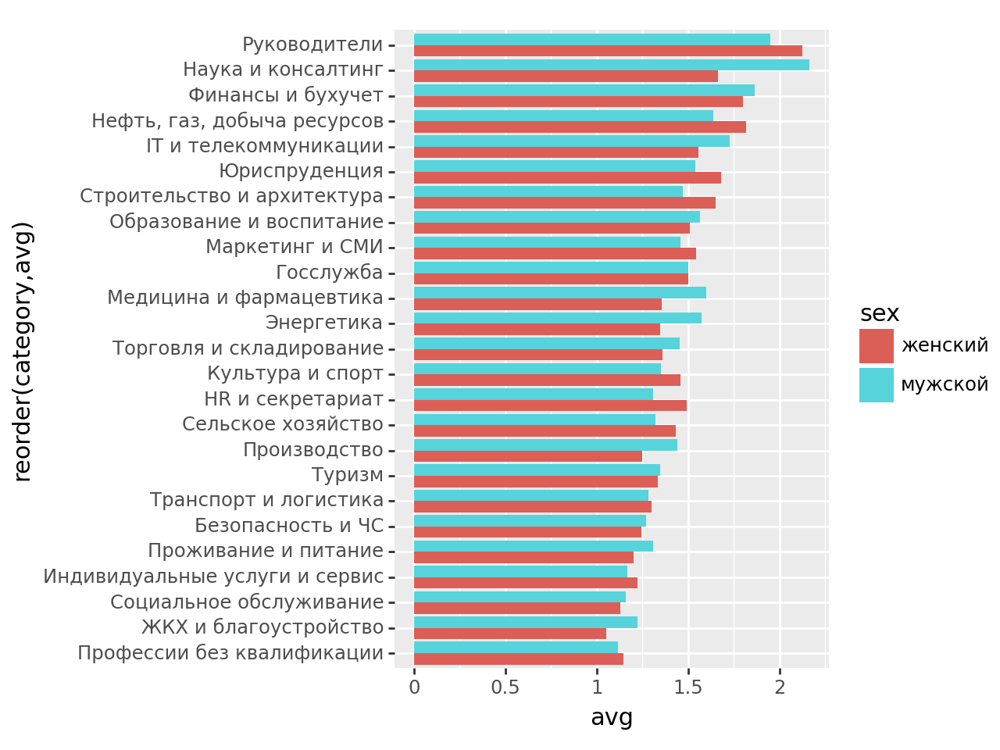

<Figure Size: (640 x 480)>

In [4]:

resume.loc[resume['url']=="https://enbek.kz/ru/resume/analitik~5270308"]['experience_periods']

import numpy as np
from plotnine import *
t = (
resume
    .groupby(["category","sex"],as_index=False)
    .agg(avg=("experience_cnt","mean"))
)

(
ggplot(t, aes("reorder(category,avg)","avg",fill="sex"))+
    geom_bar(stat='identity',position='dodge')+
    coord_flip()

)


In [5]:
jd[["title",'skills',"duties","education","personal_skills"]]


,title,skills,duties,education,personal_skills
0,Дворник,Уборка общественных зон и служебных помещений;,Уборка территории детского сада,общее среднее (с 1 по 11/12 классы),Адаптивность;Ответственность;
1,Административный секретарь,Прием и распределение входящих звонков;Ведение...,NaN,высшее,Ответственность;Пунктуальность;
2,Водитель санитарной машины,Ремонт неисправностей в работе транспортных ср...,1 Не оставлять автомобиль без присмотра за пре...,послесреднее,Адаптивность;Ответственность;Пунктуальность;
3,Грузчик,Перемещение и укладка грузов;Осуществление по...,Погрузка и разгрузка товара на складе.,послесреднее,Ответственность;Пунктуальность;Терпеливость;
4,Начальник управления,NaN,"Обязанности:Организация, координация, управлен...",высшее,NaN
...,...,...,...,...,...
2408,Оператор Call-центра,NaN,"Мы верим, что новое качество жизни можно нести...",общее среднее (с 1 по 11/12 классы),NaN
2409,Главный бухгалтер,NaN,Обязанности:Осуществляет формирование и своевр...,высшее,NaN
2410,Главный экономист,NaN,Обязанности:Принимает участие в формировании б...,высшее,NaN
2411,Электрогазосварщик,NaN,Должностные обязанности:Содержать в исправном ...,общее среднее (с 1 по 11/12 классы),NaN


In [6]:
resume[["title",'skills',"experience_duties","education","personal_skills"]]

,title,skills,experience_duties,education,personal_skills
0,Администратор,Организация труда и управление персоналом;Собл...,"Контроль и качество работы продавцов, еженедел...",высшее,Ответственность;Стрессоустойчивость;Самостояте...
1,Медицинский регистратор,Обработка и анализ полученной информации;Веден...,NaN,высшее,Ответственность;Пунктуальность;Самостоятельнос...
2,"Санитар, санитарка",Проведение уборки;Контроль за соблюдением сани...,NaN,высшее,Самостоятельность и ответственность
3,Аналитик баз данных,Разработка БД и работа с данными;Подготовка от...,- Осуществляет процесс устранения инцидентов: ...,высшее,Адаптивность;Ответственность;Понимание бизнеса...
4,Продавец,Прием товарной продукции и оформление ценников...,NaN,общее среднее (с 1 по 11/12 классы),Ответственность
...,...,...,...,...,...
23683,"Главный специалист, Категория С-R-4",Стрессоустойчивость;Ответственность;Стратегиче...,NaN,послевузовское,Ответственность
23684,Фотограф,Работа на компьютере для корректировки фотогра...,NaN,общее среднее (с 1 по 11/12 классы),Ответственность;Пунктуальность;Понимание бизнеса
23685,Специалист по связям с общественностью,Проведение мероприятий по формированию бренда ...,NaN,высшее,Ответственность;Пунктуальность
23686,Биотехнолог,"Микробиологические операции, исследования и ан...",NaN,послесреднее,Адаптивность


In [81]:
pd.set_option('max_colwidth', 400)
db=(
    recommendations[['url_jd',"url_resume","title_sim","skills_sim","duties_sim","education_sim"]]
    .assign(total_sim=lambda x: (x["title_sim"]+x["skills_sim"]+x['duties_sim']+x["education_sim"])/4)
    .sort_values("total_sim",ascending=False)
#     .loc[lambda x: x['url_jd']=="https://enbek.kz/ru/vacancy/ekonomist~4025051"]
#     .head(10)
)
db

,url_jd,url_resume,title_sim,skills_sim,duties_sim,education_sim,total_sim
7993,https://enbek.kz/ru/vacancy/uborshchik-v-shkolakh-uborshchik-v-shkolakh~4025943,https://enbek.kz/ru/resume/uborshchik~5269387,73,100,100,100,93.25
9917,https://enbek.kz/ru/vacancy/bukhgalter-po-uchetu~4027431,https://enbek.kz/ru/resume/bukhgalter-po-proizvodstu~5269187,100,67,100,100,91.75
4317,https://enbek.kz/ru/vacancy/bukhgalter-po-uchetu~4027431,https://enbek.kz/ru/resume/uchet-i-audit~5269609,100,52,100,100,88.00
1057,https://enbek.kz/ru/vacancy/oficiant-oficiant~4026612,https://enbek.kz/ru/resume/~5270077,100,49,100,100,87.25
6027,https://enbek.kz/ru/vacancy/uchitel-nachalnykh-klassov-v-shkole-s-russkim-yazykom-obucheniya-pedagog-nachalnoi-shkoly~4027199,https://enbek.kz/ru/resume/uchitel-nachalnykh-klassov~5269389,100,48,100,100,87.00
...,...,...,...,...,...,...,...
3434,https://enbek.kz/ru/vacancy/gruzchik-gruzchik~4026943,https://enbek.kz/ru/resume/uchitel-nachalnykh-klassov~5269730,14,0,0,33,11.75
6534,https://enbek.kz/ru/vacancy/gruzchik-gruzchik~4026943,https://enbek.kz/ru/resume/hr-biznes-partner~5269464,14,0,0,33,11.75
9634,https://enbek.kz/ru/vacancy/gruzchik-gruzchik~4026943,https://enbek.kz/ru/resume/voditel-avtobusa~5269116,14,0,0,33,11.75
6034,https://enbek.kz/ru/vacancy/gruzchik-gruzchik~4026943,https://enbek.kz/ru/resume/uchitel-nachalnykh-klassov~5269389,14,0,0,33,11.75


In [77]:
from pymongo import MongoClient
client = MongoClient('185.234.114.28', 27017) 
client

MongoClient(host=['185.234.114.28:27017'], document_class=dict, tz_aware=False, connect=True)

In [110]:
r = db.head(100).to_dict('records')
r

[{'url_jd': 'https://enbek.kz/ru/vacancy/vrach-obshchei-praktiki-dlya-shkol-vrach-obshchei-praktiki~4015066',
  'url_resume': 'https://enbek.kz/ru/resume/~5263726',
  'title_sim': 100,
  'skills_sim': 100,
  'duties_sim': 100,
  'education_sim': 100,
  'total_sim': 100.0},
 {'url_jd': 'https://enbek.kz/ru/vacancy/vospitatel-vospitatel~4021110',
  'url_resume': 'https://enbek.kz/ru/resume/pomoshchnik-vospitatelya~5257643',
  'title_sim': 100,
  'skills_sim': 100,
  'duties_sim': 100,
  'education_sim': 100,
  'total_sim': 100.0},
 {'url_jd': 'https://enbek.kz/ru/vacancy/dvornik~4009449',
  'url_resume': 'https://enbek.kz/ru/resume/dvornik~5267213',
  'title_sim': 100,
  'skills_sim': 100,
  'duties_sim': 100,
  'education_sim': 100,
  'total_sim': 100.0},
 {'url_jd': 'https://enbek.kz/ru/vacancy/usp-uborshchik-v-promyshlennykh-pomeshcheniyakh~4012567',
  'url_resume': 'https://enbek.kz/ru/resume/uborka~5267376',
  'title_sim': 100,
  'skills_sim': 100,
  'duties_sim': 100,
  'education_

In [128]:
mongo_db = client['enbek']
mongo_db.recommendations.drop()
mongo_db.recommendations.insert_many(db.to_dict('records'))

InsertManyResult([ObjectId('66757803935d81088ecb3dff'), ObjectId('66757803935d81088ecb3e00'), ObjectId('66757803935d81088ecb3e01'), ObjectId('66757803935d81088ecb3e02'), ObjectId('66757803935d81088ecb3e03'), ObjectId('66757803935d81088ecb3e04'), ObjectId('66757803935d81088ecb3e05'), ObjectId('66757803935d81088ecb3e06'), ObjectId('66757803935d81088ecb3e07'), ObjectId('66757803935d81088ecb3e08'), ObjectId('66757803935d81088ecb3e09'), ObjectId('66757803935d81088ecb3e0a'), ObjectId('66757803935d81088ecb3e0b'), ObjectId('66757803935d81088ecb3e0c'), ObjectId('66757803935d81088ecb3e0d'), ObjectId('66757803935d81088ecb3e0e'), ObjectId('66757803935d81088ecb3e0f'), ObjectId('66757803935d81088ecb3e10'), ObjectId('66757803935d81088ecb3e11'), ObjectId('66757803935d81088ecb3e12'), ObjectId('66757803935d81088ecb3e13'), ObjectId('66757803935d81088ecb3e14'), ObjectId('66757803935d81088ecb3e15'), ObjectId('66757803935d81088ecb3e16'), ObjectId('66757803935d81088ecb3e17'), ObjectId('66757803935d81088ecb3e

In [78]:
myquery = { "url_resume": "https://enbek.kz/ru/resume/~5263726" }
mongo_db = client['enbek']
mydoc = mongo_db.recommendations.find(myquery).sort("total_sim",-1).limit(20)

for x in mydoc:
    print(x)

In [8]:
import plotly.express as px
df = jd.groupby(['field', 'education'], as_index=False).agg(value=("salary", "mean")).sort_values("value",ascending=False).head(10)
bar_fig = px.bar(df,
                 y="field", x="value", color="education",  text_auto=True,orientation='h'
                 )
bar_fig.update_traces(texttemplate="%{x:.2s}")
bar_fig.update_layout(title_x=0, yaxis_title=None)
bar_fig.update_layout(yaxis = dict(tickfont = dict(size=10)))
bar_fig.update_layout(legend_title=None, xaxis_title=None, legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.02,
    xanchor="right",
    x=1
))
bar_fig.show()

In [36]:
import plotly.express as px
df = (
    jd
    .loc[lambda x: x['experience'].astype(int)>0]
    .assign(salary_log= lambda x: np.log(x['salary']),
            exp_log= lambda x: np.log(x['experience'].astype(int)))
    [["salary_log","exp_log"]]
)

line_fig = px.scatter(df, x="salary_log", y="exp_log")
line_fig

In [54]:
# n = 10  #chunk row size
# from fuzzywuzzy import fuzz, process
# import psycopg2
# from psycopg2.extras import execute_batch

# list_df = [jd[i:i+n] for i in range(0,jd.shape[0],n)]

connection = psycopg2.connect(
    host="185.234.114.28",
    database="enbek",
    user="airflow",
    password="airflow",
)
connection.autocommit = True
cursor = connection.cursor()

for i in range(38,len(list_df)):
    jd_chunk = list_df[i]    
    jd_chunk['key']=0
    resume['key']=0
    recommendations = pd.merge(resume, jd_chunk,how='outer',left_on='key',right_on='key',suffixes=("_resume","_jd")).drop("key",axis=1)
   
    recommendations=(
        recommendations[['url_jd',"url_resume","title_jd","title_resume","skills_jd","skills_resume","experience_duties","duties_jd","education_jd","education_resume"]]
            .fillna("")
            .assign(
                title_sim= lambda x: x[['title_jd', 'title_resume']].apply(lambda x: fuzz.partial_ratio(*x), axis=1),
                skills_sim= lambda x: x[['skills_jd', 'skills_resume']].apply(lambda x: fuzz.partial_ratio(*x), axis=1),
                duties_sim= lambda x: x[['experience_duties', 'duties_jd']].apply(lambda x: fuzz.partial_ratio(*x), axis=1),
                education_sim= lambda x: x[['education_jd', 'education_resume']].apply(lambda x: fuzz.partial_ratio(*x), axis=1),
                total_sim=lambda x: (x["title_sim"]+x["skills_sim"]+x['duties_sim']+x["education_sim"])/4,
                rank = lambda x: x.groupby(["url_jd"])['total_sim'].rank(method="first", ascending=False)                   
                   )
            .loc[lambda x: x['total_sim']>=70]
            .loc[lambda x: x['rank']<=20] 
            .sort_values("total_sim",ascending=False)
    )[['url_jd',"url_resume","title_sim","skills_sim","duties_sim","education_sim","total_sim"]]
    recommendations = recommendations.to_dict('records')
    t = tuple([(x['url_resume'],x['url_jd'],x['title_sim'],x['skills_sim'],x['duties_sim'],x['education_sim'],x['total_sim']) for x in recommendations])
    execute_batch(cursor, "INSERT INTO recommendations (url_resume,url_jd,title_sim, skills_sim, duties_sim, education_sim, total_sim) VALUES (%s, %s, %s,%s,%s,%s,%s)", t)
    
    print("chunk {0} out of {1} has been processed".format(i,len(list_df)))

/tmp/ipykernel_461351/567347221.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



KeyboardInterrupt: 

In [189]:
(
    recommendations       
        .assign(rank = lambda x: x.groupby(["url_jd"])['skills_sim']
        .rank(method="first", ascending=False))
        [['url_jd',"url_resume","skills_sim",'rank']]
        .loc[lambda x: x['skills_sim']>70]
#         .loc[lambda x: x['url_jd']=="https://enbek.kz/ru/vacancy/gruzchik-gruzchik~4027572"]
        .sort_values(["skills_sim"],ascending=False)
)

,url_jd,url_resume,skills_sim,rank
8353,https://enbek.kz/ru/vacancy/garderobshchica-dlya-sbora-i-khraneniya-lichnykh-veshchei-pacientov-garderobshchik~4004573,https://enbek.kz/ru/resume/~5211753,100,1.0
2882,https://enbek.kz/ru/vacancy/inzhener-sistem-informacionnoi-bezopasnosti-inzhener-infrastruktury-informacionnykh-tekhnologii~4017846,https://enbek.kz/ru/resume/inzhener-infrastruktury-informacionnykh-tekhnologii~5211737,100,1.0
7917,https://enbek.kz/ru/vacancy/podsobnyi-rabochii-podsobnyi-rabochii~4013514,https://enbek.kz/ru/resume/~5211753,100,1.0
7858,https://enbek.kz/ru/vacancy/podsobnyi-rabochii-podsobnyi-rabochii~4014559,https://enbek.kz/ru/resume/~5211753,100,1.0
7829,"https://enbek.kz/ru/vacancy/sanitarka-sanitar,-sanitarka~4014926",https://enbek.kz/ru/resume/~5211753,100,1.0
...,...,...,...,...
23386,https://enbek.kz/ru/vacancy/elektrik-na-proizvodstvennoi-baze-slesar-elektrik-po-remontu-elektrooborudovaniya~3989215,https://enbek.kz/ru/resume/raznorabochii~5211451,71,1.0
22634,https://enbek.kz/ru/vacancy/montazhnik-malyar~4008828,https://enbek.kz/ru/resume/raznorabochii~5211451,71,1.0
21928,https://enbek.kz/ru/vacancy/raznorabochii-dorozhnyi-rabochii~4023995,https://enbek.kz/ru/resume/raznorabochii~5211451,71,1.0
69,https://enbek.kz/ru/vacancy/sekretar-deloproizvoditel-sekretar~4026071,https://enbek.kz/ru/resume/ofis-menedzher-v-energosnabzhayushchei-organizacii~5211659,71,1.0


In [5]:

import mlflow

from sklearn.model_selection import train_test_split
from sklearn.datasets import load_diabetes
from sklearn.ensemble import RandomForestRegressor,GradientBoostingRegressor

mlflow.set_tracking_uri("http://185.234.114.28:3333")
mlflow.set_experiment("equity_feature")
mlflow.autolog()

db = load_diabetes()
X_train, X_test, y_train, y_test = train_test_split(db.data, db.target)

# Create and train models.
rf = GradientBoostingRegressor(n_estimators=250, max_depth=3, max_features=5)
rf.fit(X_train, y_train)

# Use the model to make predictions on the test dataset.
predictions = rf.predict(X_test)

2024/06/25 13:59:41 INFO mlflow.tracking.fluent: Autologging successfully enabled for sklearn.
2024/06/25 13:59:41 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '125b4ece3f1b4667bd14ca8bd9e9e3a9', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow
